## Import require libraries

In [1]:
import torch
import torch.nn as nn
import torch.nn.parallel
import torch.backends.cudnn as cudnn
# import torch.optim as optim
import torch.utils.data
from torch.utils.data import DataLoader, Dataset, TensorDataset
from torchvision import datasets, transforms, models
from torchvision import utils as vutils

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from sklearn.model_selection import train_test_split

from timeit import default_timer as timer
from tqdm.auto import tqdm

In [2]:
import matplotlib.animation as animation
from IPython.display import HTML

In [3]:
!pip install torchmetrics -q

from torchmetrics.classification import MulticlassAccuracy

In [4]:
from pathlib import Path
from google.colab import drive
drive.mount('/content/drive/')

Drive already mounted at /content/drive/; to attempt to forcibly remount, call drive.mount("/content/drive/", force_remount=True).


## Device Agnostic code

In [5]:
device = 'cuda' if torch.cuda.is_available() else 'cpu'
device

'cuda'

## Load data

In [6]:
info = pd.read_csv("drive/MyDrive/Course/Sem2/DLOps/data/GAN_data.csv", sep = ',', )

In [7]:
info

,pixel_0000,pixel_0001,pixel_0002,pixel_0003,pixel_0004,pixel_0005,pixel_0006,pixel_0007,pixel_0008,pixel_0009,...,pixel_1015,pixel_1016,pixel_1017,pixel_1018,pixel_1019,pixel_1020,pixel_1021,pixel_1022,pixel_1023,character
0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,character_01_ka
1,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,character_01_ka
2,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,character_01_ka
3,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,character_01_ka
4,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,character_01_ka
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
91995,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,digit_9
91996,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,digit_9
91997,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,digit_9
91998,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,digit_9


In [8]:
X, Y = info.iloc[:,:1024].values, info.iloc[:, -1:].values

In [9]:
X.shape, X

((92000, 1024),
 array([[0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        ...,
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0]]))

In [10]:
Y.shape, Y

((92000, 1),
 array([['character_01_ka'],
        ['character_01_ka'],
        ['character_01_ka'],
        ...,
        ['digit_9'],
        ['digit_9'],
        ['digit_9']], dtype=object))

In [11]:
img_data = []
for x in X:
  # np.expand_dims(x.reshape(32,32), axis=0)
  img_data.append(x.reshape(32,32))

img_data = np.array(img_data)

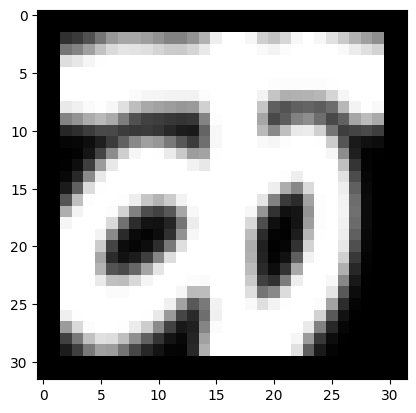

In [12]:
plt.imshow(img_data[0].reshape(32,32), cmap = "gray")

In [13]:
cls_nm = np.unique(Y)

In [14]:
cls_nm = list(cls_nm)
cls_nm

['character_01_ka',
 'character_02_kha',
 'character_03_ga',
 'character_04_gha',
 'character_05_kna',
 'character_06_cha',
 'character_07_chha',
 'character_08_ja',
 'character_09_jha',
 'character_10_yna',
 'character_11_taamatar',
 'character_12_thaa',
 'character_13_daa',
 'character_14_dhaa',
 'character_15_adna',
 'character_16_tabala',
 'character_17_tha',
 'character_18_da',
 'character_19_dha',
 'character_20_na',
 'character_21_pa',
 'character_22_pha',
 'character_23_ba',
 'character_24_bha',
 'character_25_ma',
 'character_26_yaw',
 'character_27_ra',
 'character_28_la',
 'character_29_waw',
 'character_30_motosaw',
 'character_31_petchiryakha',
 'character_32_patalosaw',
 'character_33_ha',
 'character_34_chhya',
 'character_35_tra',
 'character_36_gya',
 'digit_0',
 'digit_1',
 'digit_2',
 'digit_3',
 'digit_4',
 'digit_5',
 'digit_6',
 'digit_7',
 'digit_8',
 'digit_9']

## replace label with class index

In [15]:
for i in range(len(cls_nm)):
  Y[Y == cls_nm[i]] = i
  # for y in Y:

  #   # print(y[0], cls_nm[i])
  #   if y[0] == cls_nm[i]:
  #     y[0] = i


In [16]:
Y

array([[0],
       [0],
       [0],
       ...,
       [45],
       [45],
       [45]], dtype=object)

In [17]:
x_train, x_test, y_train, y_test = train_test_split(img_data, Y, test_size = 0.25, random_state = 64, shuffle = True)

In [18]:
y_train = y_train.astype(int)
y_test = y_test.astype(int)


In [19]:
up_x_train, up_x_test = [], []
for x in x_train:
  up_x_train.append(np.expand_dims(x, axis=0))

for x in x_test:
  up_x_test.append(np.expand_dims(x, axis=0))

In [20]:
up_x_train, up_x_test = np.array(up_x_train), np.array(up_x_test)

In [21]:
up_x_train[0]

array([[[0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        ...,
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0]]])

In [22]:
train_data, test_data = [], []
for x,y in zip(up_x_train, y_train):
  x = torch.from_numpy(x)
  # print(y[0])
  y = int(y[0])
  x = x.type(torch.float)
  train_data.append((x,y))

for x,y in zip(up_x_test, y_test):
  x = torch.from_numpy(x)
  y = int(y[0])
  x = x.type(torch.float)
  test_data.append((x,y))

In [23]:
class CustomTensorDataset(Dataset):
    """TensorDataset with support of transforms.
    """
    def __init__(self, tensors, transform=None):
        assert all(tensors[0].size(0) == tensor.size(0) for tensor in tensors)
        self.tensors = tensors
        self.transform = transform


    def __len__(self):
        return self.tensors[0].size(0)

    def __getitem__(self, index):
        x = self.tensors[0][index]

        if self.transform:
            x = self.transform(x)

        y = self.tensors[1][index]

        return x, y

In [24]:
tensor_x_train = torch.Tensor(up_x_train) # transform to torch tensor
tensor_y_train = torch.Tensor(y_train)

tensor_x_test = torch.Tensor(up_x_test) # transform to torch tensor
tensor_y_test = torch.Tensor(y_test)

In [25]:
transform = transforms.Compose([
    transforms.Resize((64,64))
    # transforms.ToTensor()
])

In [26]:
train_dataset = CustomTensorDataset(tensors=(tensor_x_train, tensor_y_train), transform=transform)
test_dataset = CustomTensorDataset(tensors=(tensor_x_test, tensor_y_test), transform=transform)

In [27]:
# train_dataset = TensorDataset(tensor_x_train,tensor_y_train)
# test_dataset = TensorDataset(tensor_x_test,tensor_y_test)

In [28]:
train_dataset, test_dataset

(<__main__.CustomTensorDataset at 0x7fee7a2de7c0>,
 <__main__.CustomTensorDataset at 0x7fee7a2deeb0>)

## Make dataloader

In [29]:
BATCH_SIZE = 32
train_dataloader = DataLoader(dataset = train_dataset, batch_size = BATCH_SIZE, shuffle = True)
test_dataloader = DataLoader(dataset = test_dataset, batch_size = BATCH_SIZE, shuffle = False)

In [30]:
print(f'Total {len(train_dataloader)} of train each of {BATCH_SIZE} batches.')
print(f'Total {len(test_dataloader)} of test each of {BATCH_SIZE} batches.')

Total 2157 of train each of 32 batches.
Total 719 of test each of 32 batches.


## HyperParameters

In [31]:
# Root directory for dataset
dataroot = "data/celeba"

# Number of workers for dataloader
workers = 2

# Batch size during training
batch_size = 32

# Spatial size of training images. All images will be resized to this
#   size using a transformer.
image_size = 64

# Number of channels in the training images. For color images this is 3
nc = 1

# Size of z latent vector (i.e. size of generator input)
nz = 1

# Size of feature maps in generator
ngf = 64

# Size of feature maps in discriminator
ndf = 64

# Number of training epochs
num_epochs = 64

# Learning rate for optimizers
lr = 0.0003

# Beta1 hyperparameter for Adam optimizers
beta1 = 0.5

# number of gpu
ngpu = 1

/usr/local/lib/python3.9/dist-packages/torchvision/transforms/functional.py:1603: UserWarning: The default value of the antialias parameter of all the resizing transforms (Resize(), RandomResizedCrop(), etc.) will change from None to True in v0.17, in order to be consistent across the PIL and Tensor backends. To suppress this warning, directly pass antialias=True (recommended, future default), antialias=None (current default, which means False for Tensors and True for PIL), or antialias=False (only works on Tensors - PIL will still use antialiasing). This also applies if you are using the inference transforms from the models weights: update the call to weights.transforms(antialias=True).
  warnings.warn(


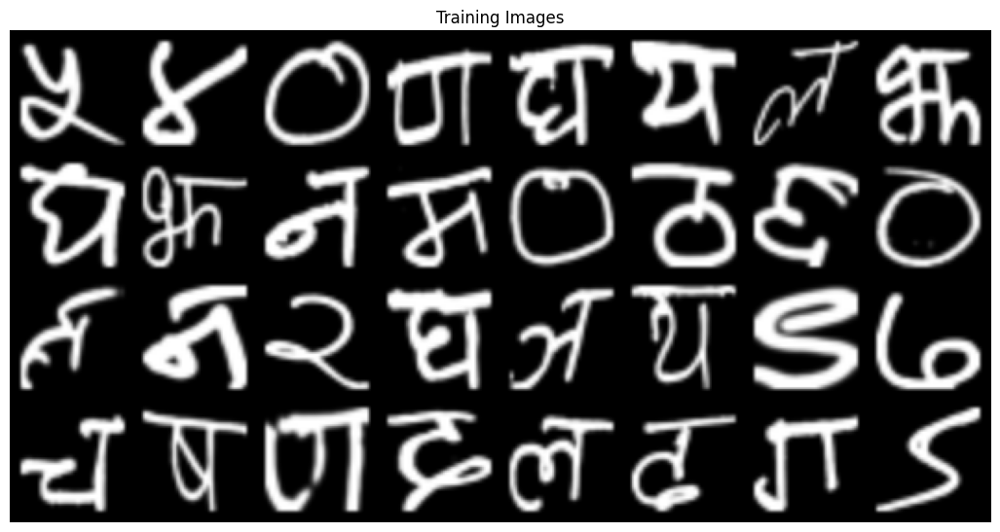

In [32]:
real_batch = next(iter(train_dataloader))
plt.figure(figsize=(13,13))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)))

## Weight INIT

In [33]:
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

## Generator

In [34]:
class Generator(nn.Module):
    def __init__(self, ngpu):
        super(Generator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input is Z, going into a convolution
            nn.ConvTranspose2d( nz, ngf * 8, 4, 1, 0, bias=False),
            nn.BatchNorm2d(ngf * 8),
            nn.ReLU(True),
            # state size. ``(ngf*8) x 4 x 4``
            nn.ConvTranspose2d(ngf * 8, ngf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 4),
            nn.ReLU(True),
            # state size. ``(ngf*4) x 8 x 8``
            nn.ConvTranspose2d( ngf * 4, ngf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 2),
            nn.ReLU(True),
            # state size. ``(ngf*2) x 16 x 16``
            nn.ConvTranspose2d( ngf * 2, ngf, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf),
            nn.ReLU(True),
            # state size. ``(ngf) x 32 x 32``
            nn.ConvTranspose2d( ngf, nc, 4, 2, 1, bias=False),
            nn.Tanh()
            # state size. ``(nc) x 64 x 64``
        )

    def forward(self, input):
        return self.main(input)

## Discriminator

In [35]:
class Discriminator(nn.Module):
    def __init__(self, ngpu):
        super(Discriminator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input is ``(nc) x 64 x 64``
            nn.Conv2d(nc, ndf, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. ``(ndf) x 32 x 32``
            nn.Conv2d(ndf, ndf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 2),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. ``(ndf*2) x 16 x 16``
            nn.Conv2d(ndf * 2, ndf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 4),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. ``(ndf*4) x 8 x 8``
            nn.Conv2d(ndf * 4, ndf * 8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 8),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. ``(ndf*8) x 4 x 4``
            nn.Conv2d(ndf * 8, 1, 4, 1, 0, bias=False),
            nn.Sigmoid()
        )

    def forward(self, input):
        return self.main(input)

In [36]:
# Create the generator
netG = Generator(ngpu).to(device)

# Handle multi-GPU if desired
if (device == 'cuda') and (ngpu > 1):
    netG = nn.DataParallel(netG, list(range(ngpu)))

# Apply the ``weights_init`` function to randomly initialize all weights
#  to ``mean=0``, ``stdev=0.02``.
netG.apply(weights_init)

# Print the model
print(netG)

Generator(
  (main): Sequential(
    (0): ConvTranspose2d(1, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace=True)
    (9): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU(inplace=True)
    (12): ConvTranspose2d(64, 1, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (13): Tanh()
  )
)


In [37]:
# Create the Discriminator
netD = Discriminator(ngpu).to(device)

# Handle multi-GPU if desired
if (device == 'cuda') and (ngpu > 1):
    netD = nn.DataParallel(netD, list(range(ngpu)))

# Apply the ``weights_init`` function to randomly initialize all weights
# like this: ``to mean=0, stdev=0.2``.
netD.apply(weights_init)

# Print the model
print(netD)

Discriminator(
  (main): Sequential(
    (0): Conv2d(1, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace=True)
    (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2, inplace=True)
    (8): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (9): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): LeakyReLU(negative_slope=0.2, inplace=True)
    (11): Conv2d(512, 1, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (12): Sigmoid()
  )
)


## Loss function and optimizer for GAN

In [38]:
# Initialize the ``BCELoss`` function
criterion = nn.BCELoss()

# Create batch of latent vectors that we will use to visualize
#  the progression of the generator
fixed_noise = torch.randn(32, nz, 1, 1, device=device)

# Establish convention for real and fake labels during training
real_label = 1.
fake_label = 0.

# Setup Adam optimizers for both G and D
optimizerD = torch.optim.Adam(netD.parameters(), lr=lr, betas=(beta1, 0.999))
optimizerG = torch.optim.Adam(netG.parameters(), lr=lr, betas=(beta1, 0.999))

In [39]:
img_list = []
G_losses = []
D_losses = []
iters = 0

print("Starting Training Loop...")
# For each epoch
for epoch in tqdm(range(num_epochs)):
    # For each batch in the dataloader
    for i, data in enumerate(train_dataloader, 0):

        ############################
        # (1) Update D network: maximize log(D(x)) + log(1 - D(G(z)))
        ###########################
        ## Train with all-real batch
        netD.zero_grad()
        # Format batch
        real_cpu = data[0].to(device)
        b_size = real_cpu.size(0)
        label = torch.full((b_size,), real_label, dtype=torch.float, device=device)
        # Forward pass real batch through D
        output = netD(real_cpu).view(-1)
        # Calculate loss on all-real batch
        errD_real = criterion(output, label)
        # Calculate gradients for D in backward pass
        errD_real.backward()
        D_x = output.mean().item()

        ## Train with all-fake batch
        # Generate batch of latent vectors
        noise = torch.randn(b_size, nz, 1, 1, device=device)
        # Generate fake image batch with G
        fake = netG(noise)
        label.fill_(fake_label)
        # Classify all fake batch with D
        output = netD(fake.detach()).view(-1)
        # Calculate D's loss on the all-fake batch
        errD_fake = criterion(output, label)
        # Calculate the gradients for this batch, accumulated (summed) with previous gradients
        errD_fake.backward()
        D_G_z1 = output.mean().item()
        # Compute error of D as sum over the fake and the real batches
        errD = errD_real + errD_fake
        # Update D
        optimizerD.step()

        ############################
        # (2) Update G network: maximize log(D(G(z)))
        ###########################
        netG.zero_grad()
        label.fill_(real_label)  # fake labels are real for generator cost
        # Since we just updated D, perform another forward pass of all-fake batch through D
        output = netD(fake).view(-1)
        # Calculate G's loss based on this output
        errG = criterion(output, label)
        # Calculate gradients for G
        errG.backward()
        D_G_z2 = output.mean().item()
        # Update G
        optimizerG.step()

        # Output training stats
        if i % 100 == 0:
            print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f'
                  % (epoch+1, num_epochs, i+1, len(train_dataloader),
                     errD.item(), errG.item(), D_x, D_G_z1, D_G_z2))

        # Save Losses for plotting later
        G_losses.append(errG.item())
        D_losses.append(errD.item())

        # Check how the generator is doing by saving G's output on fixed_noise
        if (iters % 500 == 0) or ((epoch == num_epochs-1) and (i == len(train_dataloader)-1)):
            with torch.no_grad():
                fake = netG(fixed_noise).detach().cpu()
            img_list.append(vutils.make_grid(fake, padding=2, normalize=True))

        iters += 1

Starting Training Loop...


  0%|          | 0/64 [00:00<?, ?it/s]

[1/64][1/2157]	Loss_D: 1.4473	Loss_G: 13.4345	D(x): 0.4772	D(G(z)): 0.3882 / 0.0590
[1/64][101/2157]	Loss_D: 0.3272	Loss_G: 6.2997	D(x): 0.8166	D(G(z)): 0.0050 / 0.0151
[1/64][201/2157]	Loss_D: 0.1643	Loss_G: 3.9373	D(x): 0.8887	D(G(z)): 0.0316 / 0.0245
[1/64][301/2157]	Loss_D: 0.0661	Loss_G: 5.2601	D(x): 0.9775	D(G(z)): 0.0395 / 0.0057
[1/64][401/2157]	Loss_D: 0.0246	Loss_G: 6.0573	D(x): 0.9807	D(G(z)): 0.0027 / 0.0035
[1/64][501/2157]	Loss_D: 0.5690	Loss_G: 7.5056	D(x): 0.9148	D(G(z)): 0.1968 / 0.0024
[1/64][601/2157]	Loss_D: 0.0092	Loss_G: 6.1223	D(x): 0.9950	D(G(z)): 0.0041 / 0.0025
[1/64][701/2157]	Loss_D: 0.0026	Loss_G: 7.1637	D(x): 0.9996	D(G(z)): 0.0022 / 0.0015
[1/64][801/2157]	Loss_D: 0.0020	Loss_G: 7.4035	D(x): 0.9997	D(G(z)): 0.0017 / 0.0013
[1/64][901/2157]	Loss_D: 0.0012	Loss_G: 7.4724	D(x): 0.9998	D(G(z)): 0.0009 / 0.0007
[1/64][1001/2157]	Loss_D: 0.0030	Loss_G: 7.7043	D(x): 0.9977	D(G(z)): 0.0007 / 0.0006
[1/64][1101/2157]	Loss_D: 0.0024	Loss_G: 8.9546	D(x): 0.9977	D(G(

## Save Model

In [40]:
def save_model(MODEL_NAME, model: torch.nn.Module):

  MODEL_PATH = Path("drive/MyDrive/Course/Sem2/DLOps/")
  MODEL_PATH.mkdir(parents = True, exist_ok = True)

  # MODEL_NAME = "ad_model.pth"
  MODEL_PATH_SAVE = MODEL_PATH / MODEL_NAME

  print(f"model saved at: {MODEL_PATH_SAVE}")
  torch.save(obj = model.state_dict(), f = MODEL_PATH_SAVE)

In [41]:
save_model('netD_2.pth', netD)
save_model('netG_2.pth', netG)

model saved at: drive/MyDrive/Course/Sem2/DLOps/netD_2.pth
model saved at: drive/MyDrive/Course/Sem2/DLOps/netG_2.pth


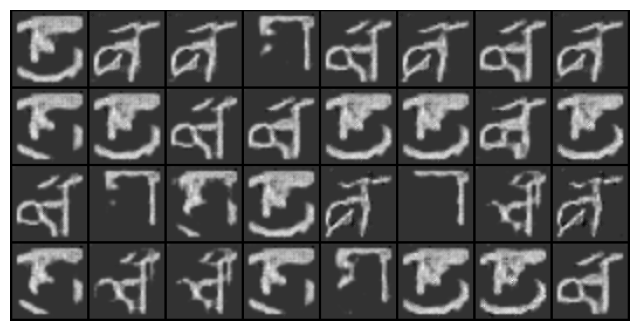

In [42]:
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

In [43]:
len(img_list)

278

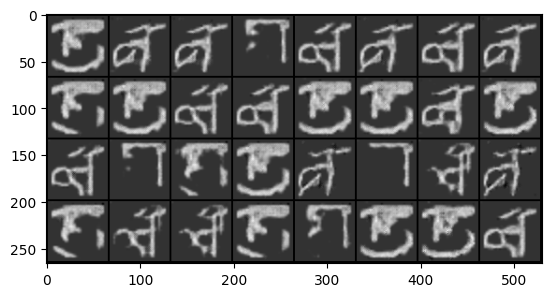

In [44]:
plt.imshow(np.transpose(img_list[-1],(1,2,0)))

/usr/local/lib/python3.9/dist-packages/torchvision/transforms/functional.py:1603: UserWarning: The default value of the antialias parameter of all the resizing transforms (Resize(), RandomResizedCrop(), etc.) will change from None to True in v0.17, in order to be consistent across the PIL and Tensor backends. To suppress this warning, directly pass antialias=True (recommended, future default), antialias=None (current default, which means False for Tensors and True for PIL), or antialias=False (only works on Tensors - PIL will still use antialiasing). This also applies if you are using the inference transforms from the models weights: update the call to weights.transforms(antialias=True).
  warnings.warn(


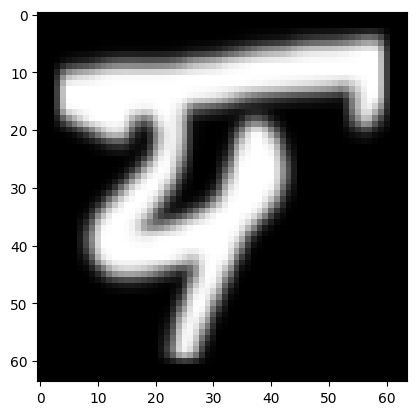

In [45]:
plt.imshow(train_dataset[1][0].permute(1,2,0), cmap = 'gray')

## load model

In [46]:
netG = Generator(ngpu).to(device)

# path
MODEL_PATH = Path("drive/MyDrive/Course/Sem2/DLOps/")

MODEL_NAME = "netG_2.pth"
MODEL_PATH_SAVE = MODEL_PATH / MODEL_NAME

if torch.cuda.is_available() == False:
  netG.load_state_dict(torch.load(f = MODEL_PATH_SAVE, map_location=torch.device('cpu')))
else:
  netG.load_state_dict(torch.load(f = MODEL_PATH_SAVE))

# model_18.state_dict()

netG = netG.to(device)

In [47]:
netD = Discriminator(ngpu).to(device)

# path
MODEL_PATH = Path("drive/MyDrive/Course/Sem2/DLOps/")

MODEL_NAME = "netD_2.pth"
MODEL_PATH_SAVE = MODEL_PATH / MODEL_NAME

if torch.cuda.is_available() == False:
  netD.load_state_dict(torch.load(f = MODEL_PATH_SAVE, map_location=torch.device('cpu')))
else:
  netD.load_state_dict(torch.load(f = MODEL_PATH_SAVE))

# model_18.state_dict()

netD = netD.to(device)

In [48]:
optimizerD = torch.optim.Adam(netD.parameters(), lr=lr, betas=(beta1, 0.999))
optimizerG = torch.optim.Adam(netG.parameters(), lr=lr, betas=(beta1, 0.999))

In [49]:
fixed_noise = torch.randn(1, nz, 1, 1, device=device)

In [50]:
fake = netG(fixed_noise).detach().cpu()

tensor([[[[0., 0., 0.,  ..., 0., 0., 0.],
          [0., 0., 0.,  ..., 0., 0., 0.],
          [0., 0., 0.,  ..., 0., 0., 0.],
          ...,
          [0., 0., 0.,  ..., 0., 0., 0.],
          [0., 0., 0.,  ..., 0., 0., 0.],
          [0., 0., 0.,  ..., 0., 0., 0.]]]])


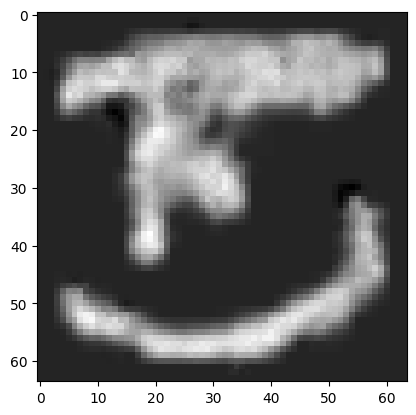

In [51]:
plt.imshow(fake[0].permute(1,2,0), cmap = 'gray')
print(fake)

In [52]:
len(fake[0])

1

In [53]:
train_dataset[1][0].unsqueeze(dim = 0).shape

torch.Size([1, 1, 64, 64])

In [54]:
fake[0]

tensor([[[0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         ...,
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.]]])

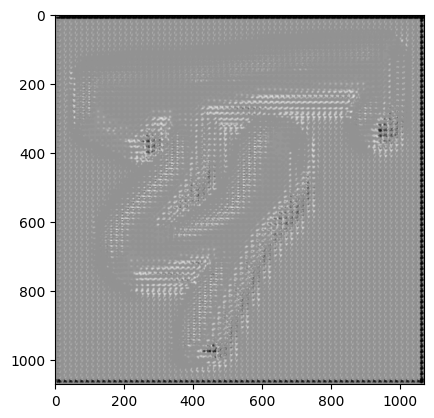

In [55]:
# fixed_noise = torch.randn(1, nz, 1, 1, device=device)
fixed_noise = train_dataset[1][0].unsqueeze(dim = 0).to(device)
fake = netG(fixed_noise).detach().cpu()
plt.imshow(fake[0].permute(1,2,0), cmap = 'gray')

In [56]:
import torchvision

In [57]:
resize_fake = torchvision.transforms.functional.resize(fake[0], (64,64), interpolation=2)

In [58]:
resize_fake.shape

torch.Size([1, 64, 64])

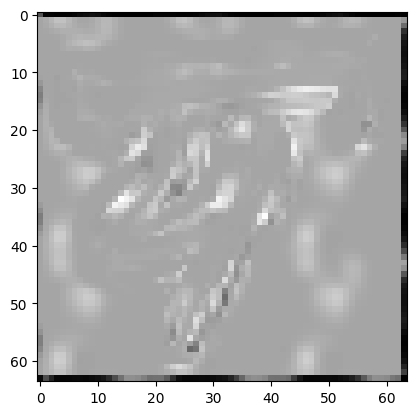

In [59]:
plt.imshow(resize_fake.permute(1,2,0), cmap = 'gray')

## make Generative image datasets

In [60]:
test_data = []
count = 0
count_list = [0 for i in range(len(cls_nm))]
# print(len(count_list))
i = 0
while count != 2300:
  fixed_noise = train_dataset[i][0].unsqueeze(dim = 0).to(device)
  label = train_dataset[i][1]
  # print(int(label.item()))
  fake = netG(fixed_noise).detach().cpu()
  resize_fake = torchvision.transforms.functional.resize(fake[0], (64,64), interpolation=2)
  # print(f"count: {count} and  label: {label} i: {i}")
  if count_list[int(label.item())] >= 50:
    i += 1
    continue
  else:
    test_data.append((resize_fake, label))
    count_list[int(label.item())] += 1
    count += 1
    i += 1
  

#   elif label == 1:
#     if count_2 >= 50:
#       i += 1
#       continue
#     else:
#       test_data.append((resize_fake, label))
#       count_2 += 1
#       count += 1
#       i += 1

#   elif label == 2:
#     # print(f"count_3: {count_3}")
#     if count_3 >= 50:
#       i += 1
#       continue
#     else:
#       test_data.append((resize_fake, label))
#       count_3 += 1
#       count += 1
#       i += 1

#   elif label == 3:
#     if count_4 >= 50:
#       i += 1
#       continue
#     else:
#       test_data.append((resize_fake, label))
#       count_4 += 1
#       count += 1
#       i += 1

#   elif label == 4:
#     if count_5 >= 50:
#       i += 1
#       continue
#     else:
#       test_data.append((resize_fake, label))
#       count_5 += 1
#       count += 1
#       i += 1

#   elif label == 5:
#     if count_6 >= 50:
#       i += 1
#       continue
#     else:
#       test_data.append((resize_fake, label))
#       count_6 += 1
#       count += 1
#       i += 1

#   elif label == 6:
#     if count_7 >= 50:
#       i += 1
#       continue
#     else:
#       test_data.append((resize_fake, label))
#       count_7 += 1
#       count += 1
#       i += 1

#   elif label == 7:
#     if count_8 >= 50:
#       i += 1
#       continue
#     else:
#       test_data.append((resize_fake, label))
#       count_8 += 1
#       count += 1
#       i += 1

#   elif label == 8:
#     if count_9 >= 50:
#       i += 1
#       continue
#     else:
#       test_data.append((resize_fake, label))
#       count_9 += 1
#       count += 1
#       i += 1

#   elif label == 9:
#     if count_10 >= 50:
#       i += 1
#       continue
#     else:
#       test_data.append((resize_fake, label))
#       count_10 += 1
#       count += 1
#       i += 1

  

In [61]:
len(test_data)

2300

## make generated dataset

In [62]:
new_test_data = torch.utils.data.ConcatDataset([test_data])

## dataloader

In [63]:
BATCH_SIZE = 32

gen_test_dataloader = DataLoader(dataset = new_test_data, batch_size = BATCH_SIZE, shuffle = False)

## Train and Test Loop

In [64]:
def train_loop(model: torch.nn.Module, dataloader: torch.utils.data.DataLoader,
               loss_fn: torch.nn.Module, optimizer: torch.optim.Optimizer,
               accuracy_fn, device: torch.device = device):
  
  train_loss, train_acc = 0, 0

  model.train()

  for batch, (x_train, y_train) in enumerate(dataloader):

    y_train = y_train.squeeze()
    y_train = y_train.type(torch.LongTensor)
    if device == 'cuda':
      x_train, y_train = x_train.to(device), y_train.to(device)
    

    # 1. Forward step
    # print("image: ",type(x_train))
    pred = model(x_train)
    

    # 2. Loss
    # print(pred, pred.shape)
    # print(y_train, y_train.shape)
    loss = loss_fn(pred, y_train)

    # 3. Grad zerostep
    optimizer.zero_grad()

    # 4. Backward
    loss.backward()

    # 5. Optimizer step
    optimizer.step()

    # print(torch.argmax(pred, dim=1))
    
    # print(y_train)

    # print(torch.argmax(pred, dim=0))
    acc = accuracy_fn(y_train.squeeze(), torch.argmax(pred, dim=1))
    train_loss += loss
    train_acc += acc

  train_loss /= len(dataloader)
  train_acc /= len(dataloader)

  # print(train_loss, train_acc)
  return train_loss, train_acc


# test
def test_loop(model: torch.nn.Module, dataloader: torch.utils.data.DataLoader,
              loss_fn: torch.nn.Module, accuracy_fn, 
              device: torch.device = device):
  
  test_loss, test_acc = 0, 0
  model.eval()
  with torch.inference_mode():
    for x_test, y_test in dataloader:
      
      y_test = y_test.squeeze()
      y_test = y_test.type(torch.LongTensor)
      if device == 'cuda':
        x_test, y_test = x_test.to(device), y_test.to(device)

      # 1. Forward
      test_pred = model(x_test)
      
      # 2. Loss and accuray
      test_loss += loss_fn(test_pred, y_test)
      test_acc += accuracy_fn(y_test, torch.argmax(test_pred, dim=1))


    test_loss /= len(dataloader)
    test_acc /= len(dataloader)

  # print(train_loss, train_acc)
  return test_loss, test_acc

## Plot graph

In [65]:
def plot_graph(train_losses, test_losses, train_accs, test_accs):
  plt.figure(figsize = (20, 8))
  plt.subplot(1, 2, 1)
  plt.plot(range(len(train_losses)), train_losses, label = "Train Loss")
  plt.plot(range(len(test_losses)), test_losses, label = "Test Loss")
  plt.legend()
  plt.xlabel("Epoches")
  plt.ylabel("Loss")
  # plt.show()

  plt.subplot(1, 2, 2)
  plt.plot(range(len(train_accs)), train_accs, label = "Train Accuracy")
  plt.plot(range(len(test_accs)), test_accs, label = "Test Accuracy")
  plt.legend()
  plt.xlabel("Epoches")
  plt.ylabel("Accuracy")
  plt.show()

## Load model

In [66]:
model_18 = models.resnet18(weights = models.ResNet18_Weights.IMAGENET1K_V1, progress = False).to(device)
model_18.conv1 = torch.nn.Conv2d(1, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False).to(device)
feature_number = model_18.fc.in_features
model_18.fc = nn.Linear(feature_number, len(cls_nm)).to(device)

model_18

ResNet(
  (conv1): Conv2d(1, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    )
    (1): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
  

## Loss and Accuracy Function

In [67]:
# loss and accuracy function
loss_fn = nn.CrossEntropyLoss()

accuracy_fn = MulticlassAccuracy(num_classes = len(cls_nm)).to(device)

## Train resnet18

  0%|          | 0/15 [00:00<?, ?it/s]

Epoch: 1
Train Loss: 0.3183 | Test Loss: 5.3071 | Train Accuray: 0.4655 | Test Accuracy: 0.0005

Epoch: 2
Train Loss: 0.1198 | Test Loss: 5.2319 | Train Accuray: 0.4906 | Test Accuracy: 0.0005

Epoch: 3
Train Loss: 0.0855 | Test Loss: 9.4789 | Train Accuray: 0.4958 | Test Accuracy: 0.0005

Epoch: 4
Train Loss: 0.0714 | Test Loss: 12.0705 | Train Accuray: 0.4975 | Test Accuracy: 0.0005

Epoch: 5
Train Loss: 0.0541 | Test Loss: 9.3631 | Train Accuray: 0.4987 | Test Accuracy: 0.0005

Epoch: 6
Train Loss: 0.0440 | Test Loss: 6.9710 | Train Accuray: 0.5013 | Test Accuracy: 0.0005

Epoch: 7
Train Loss: 0.0400 | Test Loss: 12.9920 | Train Accuray: 0.5005 | Test Accuracy: 0.0005

Epoch: 8
Train Loss: 0.0311 | Test Loss: 10.0010 | Train Accuray: 0.5023 | Test Accuracy: 0.0005

Epoch: 9
Train Loss: 0.0290 | Test Loss: 16.1579 | Train Accuray: 0.5016 | Test Accuracy: 0.0005

Epoch: 10
Train Loss: 0.0249 | Test Loss: 6.7384 | Train Accuray: 0.5026 | Test Accuracy: 0.0005

Epoch: 11
Train Loss: 0.0

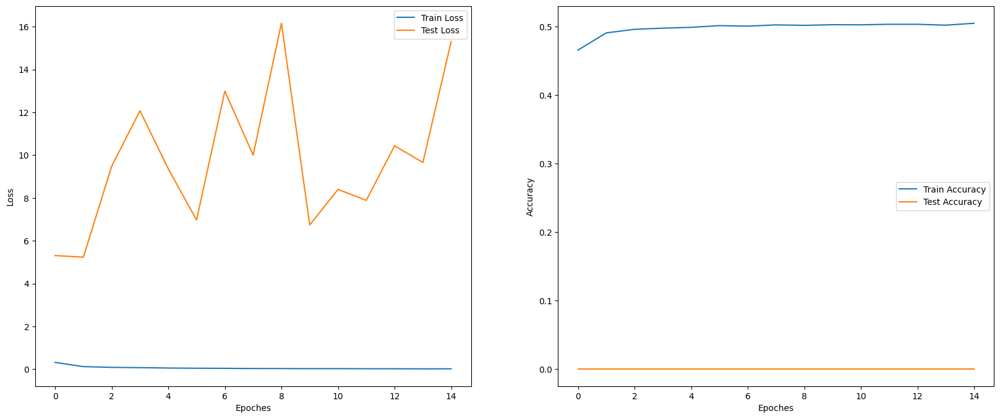

Execution time: 770.1250406219988 Seconds.


In [68]:
# init. epochs
epoches = 15


model_18 = models.resnet18(weights = 'DEFAULT', progress = False)
model_18.conv1 = torch.nn.Conv2d(1, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
feature_number = model_18.fc.in_features
model_18.fc = nn.Linear(feature_number, len(cls_nm))
model_18 = model_18.to(device)


optimizer = torch.optim.Adam(params = model_18.parameters(), lr = 1e-3)

model_18_train_loss, model_18_test_loss = [], []
model_18_train_accs, model_18_test_accs = [], []
print()

start_time = timer()
torch.manual_seed(64)
torch.cuda.manual_seed(64)
for epoch in tqdm(range(epoches)):
  print(f"Epoch: {epoch+1}")
  train_loss, train_acc = train_loop(model = model_18, dataloader = train_dataloader,
                                    loss_fn = loss_fn, optimizer = optimizer,
                                    accuracy_fn = accuracy_fn, device = device)
  
  test_loss, test_acc = test_loop(model = model_18, dataloader = gen_test_dataloader,
                                  loss_fn = loss_fn, accuracy_fn = accuracy_fn,
                                  device = device)
  
  model_18_train_loss.append(train_loss.item())
  model_18_test_loss.append(test_loss.item())
  model_18_train_accs.append(train_acc.item())
  model_18_test_accs.append(test_acc.item())


  print(f"Train Loss: {train_loss:.4f} | Test Loss: {test_loss:.4f} | Train Accuray: {train_acc:.4f} | Test Accuracy: {test_acc:.4f}")
  print()

plot_graph(model_18_train_loss, model_18_test_loss, model_18_train_accs, model_18_test_accs)

end_time = timer()

print(f"Execution time: {end_time - start_time} Seconds.")

# save_model('cifair100_model_18.pth', model_18)
# print("Model saved")

In [69]:
# model_18_train_loss, model_18_test_loss, model_18_train_accs, model_18_test_accs

## F1 Score

In [70]:
from torchmetrics.classification import MulticlassF1Score


y_preds = []
target = []
with torch.inference_mode():
  for x, y in tqdm(gen_test_dataloader, desc = "Making prediction..."):
    y = y.squeeze()
    y = y.type(torch.LongTensor)
    x, y = x.to(device), y.to(device)

    logit = model_18(x)
    pred = torch.softmax(logit.squeeze(), dim = 1).argmax(dim = 1)

    y_preds.append(pred)
    target.append(y)

y_tensor_preds = torch.cat(y_preds).to(device)
target_val = torch.cat(target).to(device)


metric = MulticlassF1Score(len(cls_nm)).to(device)
metric(target_val, y_tensor_preds)


Making prediction...:   0%|          | 0/72 [00:00<?, ?it/s]

tensor(0.0009, device='cuda:0')

## Confusion Matrix

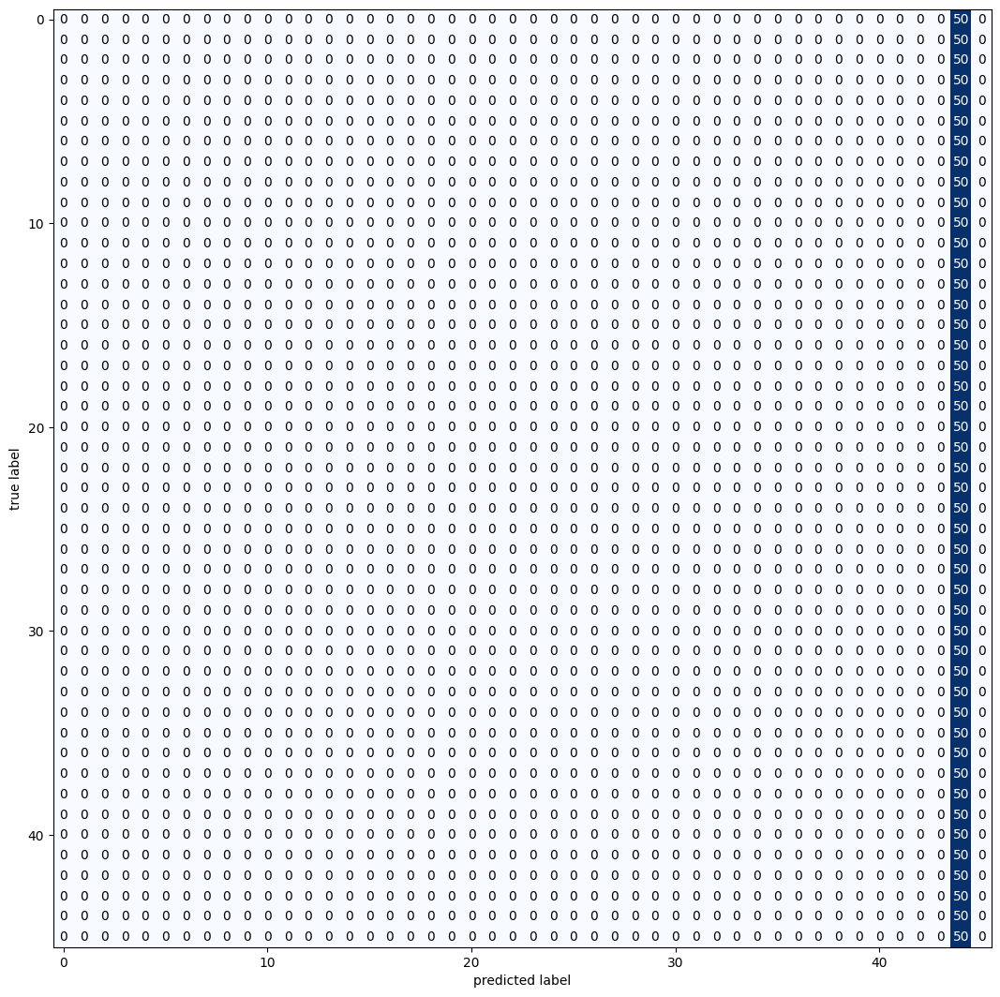

In [71]:
from torchmetrics import ConfusionMatrix
from mlxtend.plotting import plot_confusion_matrix

confmat = ConfusionMatrix(num_classes = len(cls_nm), task = 'multiclass')
confmat_tensor = confmat(preds = y_tensor_preds.cpu(), target = target_val.cpu())

fix, ax = plot_confusion_matrix(conf_mat = confmat_tensor.numpy(), figsize = (13,13))